In [1]:
# %pip install diffusers accelerate safetensors transformers

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import PIL
import torch
from diffusers import StableDiffusionInstructPix2PixPipeline, EulerAncestralDiscreteScheduler

/home/tvg/miniconda3/envs/vqa/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
model_id = "timbrooks/instruct-pix2pix"
pipe = StableDiffusionInstructPix2PixPipeline.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None)
pipe.to("cuda")
pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)

Loading pipeline components...: 100%|██████████| 6/6 [00:01<00:00,  3.13it/s]


In [4]:
def load_image(path):
    image = PIL.Image.open(path)
    image = PIL.ImageOps.exif_transpose(image)
    image = image.convert("RGB")
    
    w, h = image.size
    
    side = 512
    
    if w > h:
        new_size = (side, side * h // w)
    else:
        new_size = (side * w // h, side)
    
    image = image.resize(new_size)
    
    return image

In [8]:
def show_images(img1, img2): 
    image1 = np.array(img1)
    image2 = np.array(img2)

    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    axes[0].imshow(image1)
    axes[0].axis('off')

    axes[1].imshow(image2)
    axes[1].axis('off')

    plt.show()

In [86]:
def generate_image(img_path, prompt, num_inference_steps=10, guidance_scale=7.5, image_guidance_scale=1.5, negative_prompt=None):
    image = load_image(img_path)
    output_images = pipe(
        prompt, negative_prompt=negative_prompt,
        image=image, 
        num_inference_steps=num_inference_steps, 
        guidance_scale=guidance_scale,
        image_guidance_scale=image_guidance_scale).images
    show_images(image, output_images[0])

100%|██████████| 10/10 [00:01<00:00,  7.49it/s]


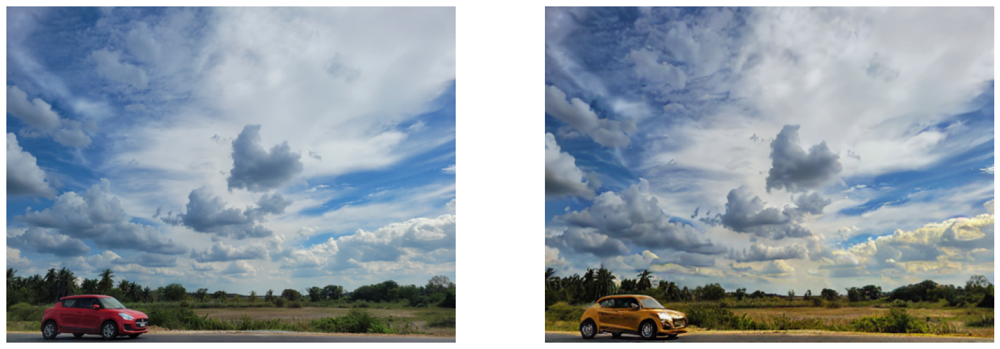

In [25]:
img_path = "images/photos/20221008_150110.jpg"
prompt = "turn the car's body into gold"

generate_image(img_path, prompt, 10, 7.5, 1.5)

100%|██████████| 20/20 [00:01<00:00, 13.00it/s]


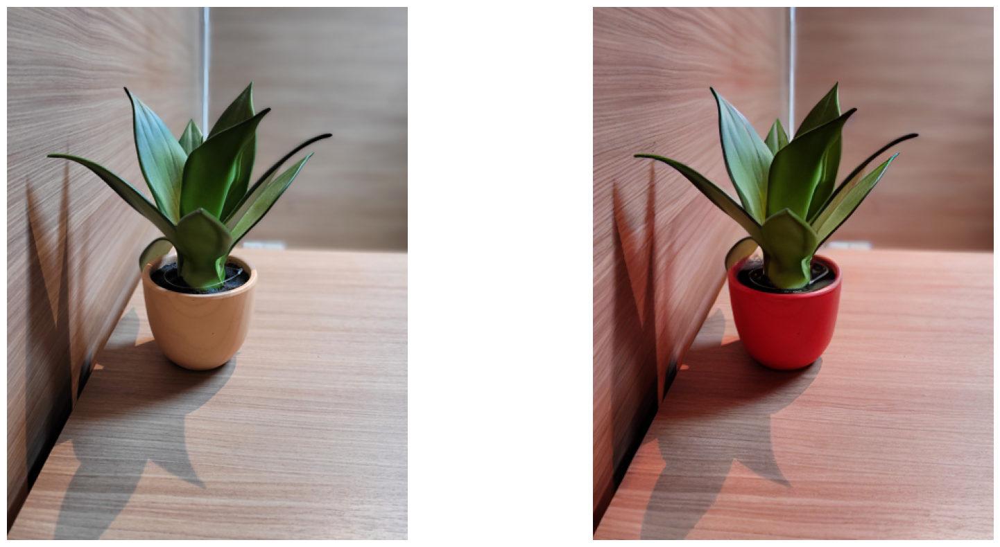

In [31]:
img_path = "images/photos/20221010_215752.jpg"
prompt = "turn the color of the pot into red"

generate_image(img_path, prompt, 20, 1, 1.5)

100%|██████████| 30/30 [00:03<00:00,  8.01it/s]


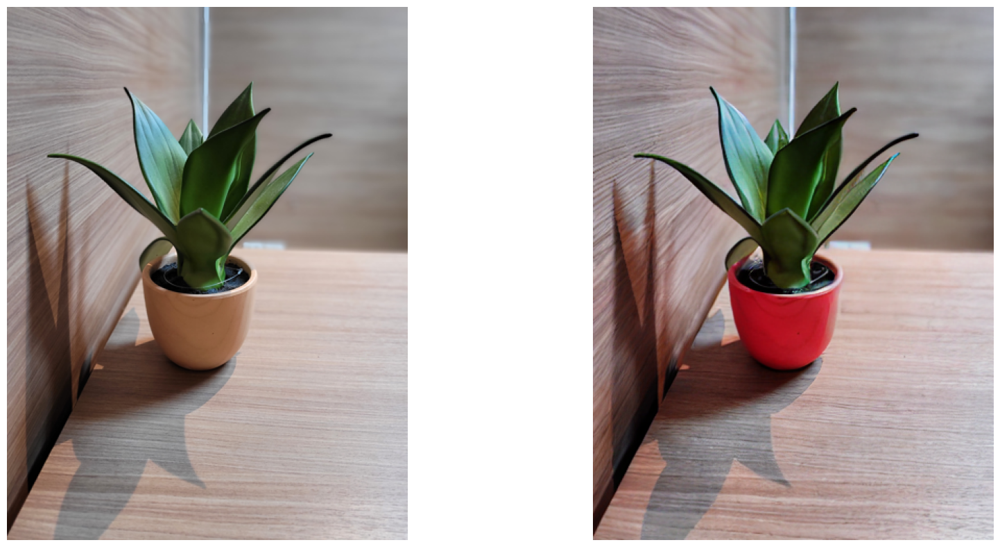

In [39]:
img_path = "images/photos/20221010_215752.jpg"
prompt = "turn the color of the pot into red"

generate_image(img_path, prompt, 30, 1.5, 2)

100%|██████████| 30/30 [00:03<00:00,  8.09it/s]


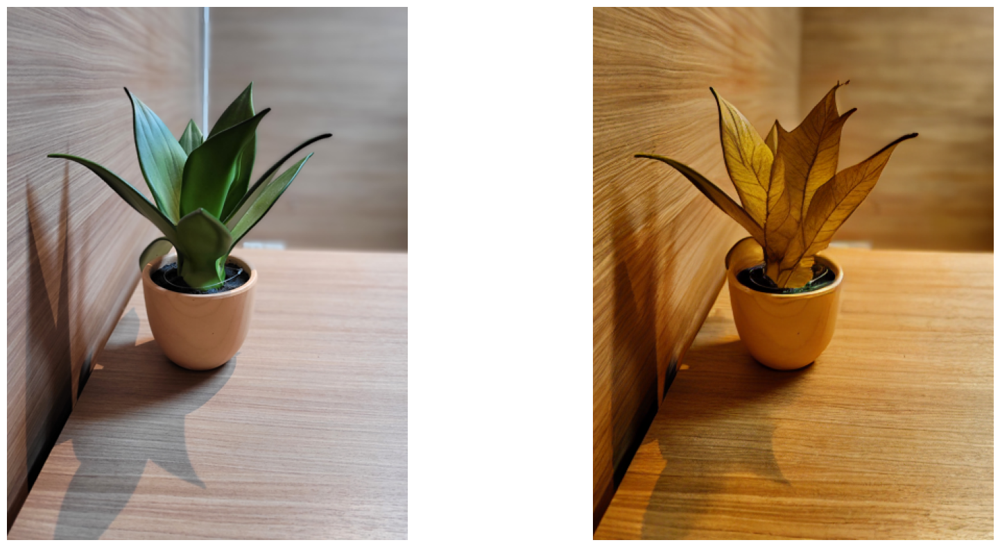

In [46]:
img_path = "images/photos/20221010_215752.jpg"
prompt = "turn the leaves golden"

generate_image(img_path, prompt, 30, 3.5, 1.5)

100%|██████████| 50/50 [00:06<00:00,  8.02it/s]


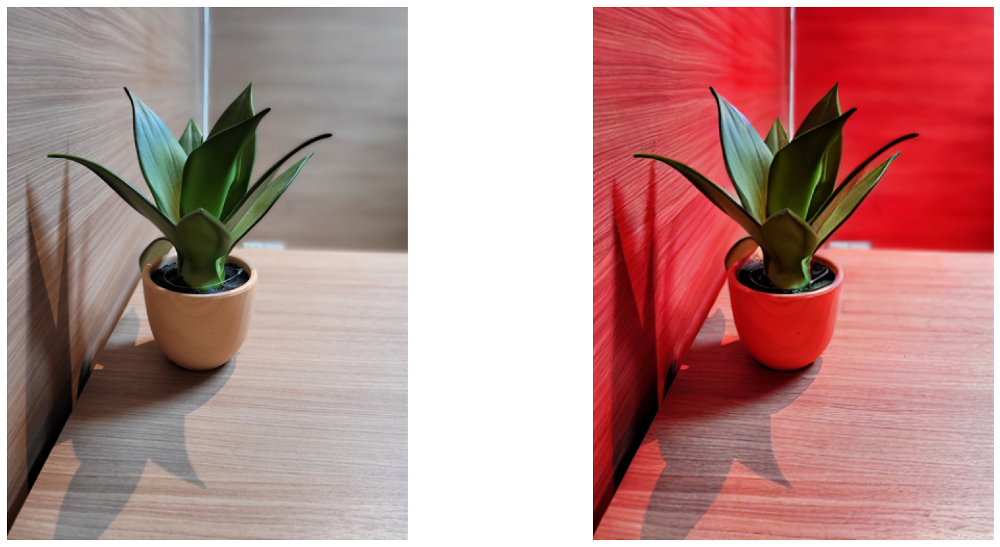

In [73]:
img_path = "images/photos/20221010_215752.jpg"
prompt = "Turn only the left wall red while the back wall and the floor should remain the same"

generate_image(img_path, prompt, 50, 5, 1.5)

100%|██████████| 50/50 [00:04<00:00, 10.14it/s]


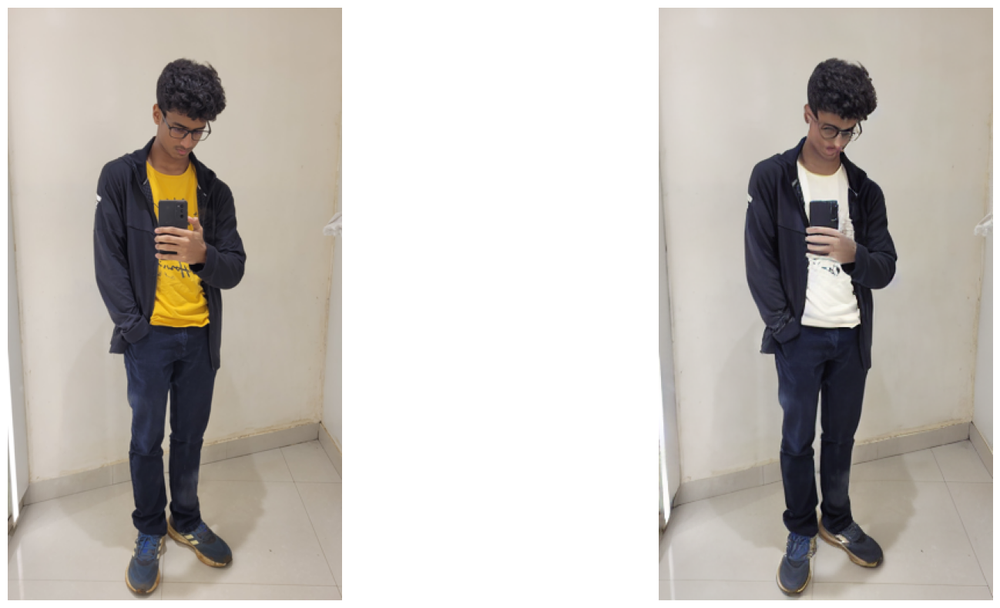

In [94]:
img_path = "images/photos/20230701_184801.jpg"
prompt = "make the shirt white colored"

generate_image(img_path, prompt, 50, 2, 1.5)

100%|██████████| 50/50 [00:04<00:00, 10.38it/s]


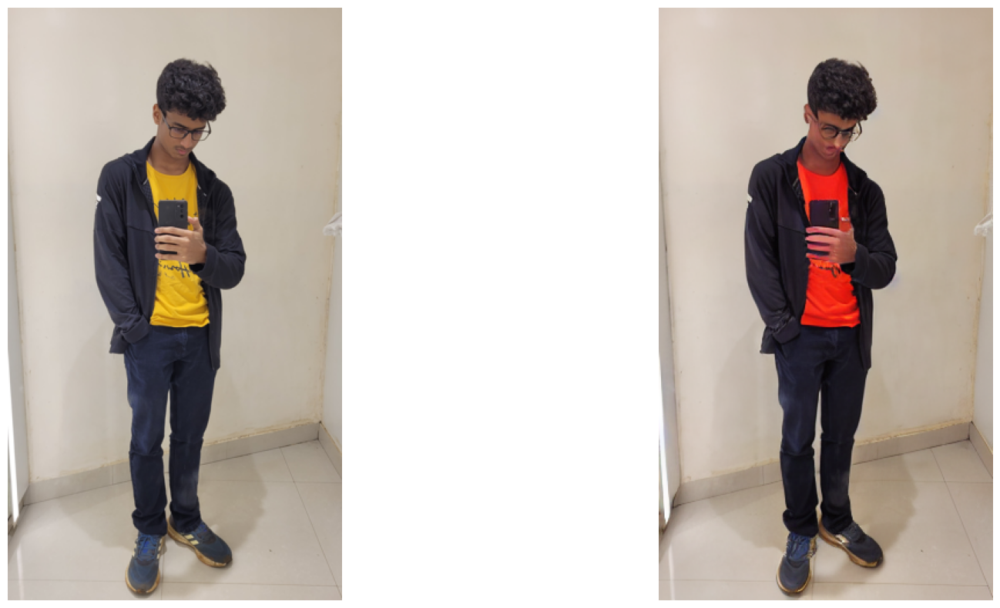

In [100]:
img_path = "images/photos/20230701_184801.jpg"
prompt = "replace the black phone in his hand into a red phone"

generate_image(img_path, prompt, 50, 2, 1.5)

100%|██████████| 50/50 [00:06<00:00,  7.95it/s]


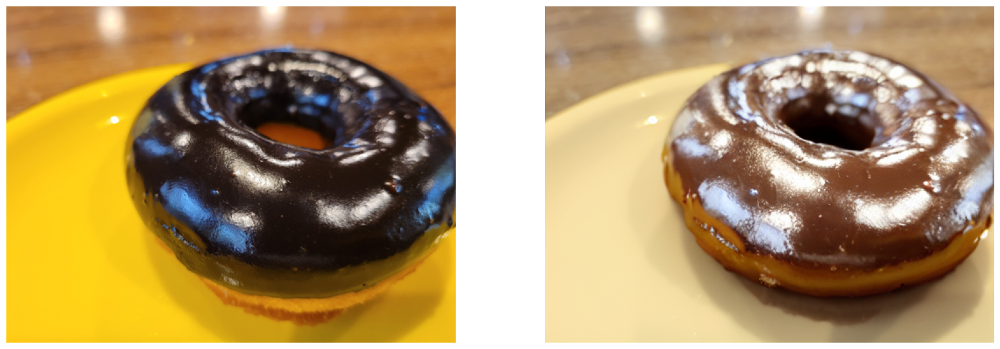

In [109]:
img_path = "images/photos/20221213_155305.jpg"
prompt = "turn the plate white without affecting the color of the donut"

generate_image(img_path, prompt, 50, 5.5, 1.5)

100%|██████████| 50/50 [00:06<00:00,  8.06it/s]


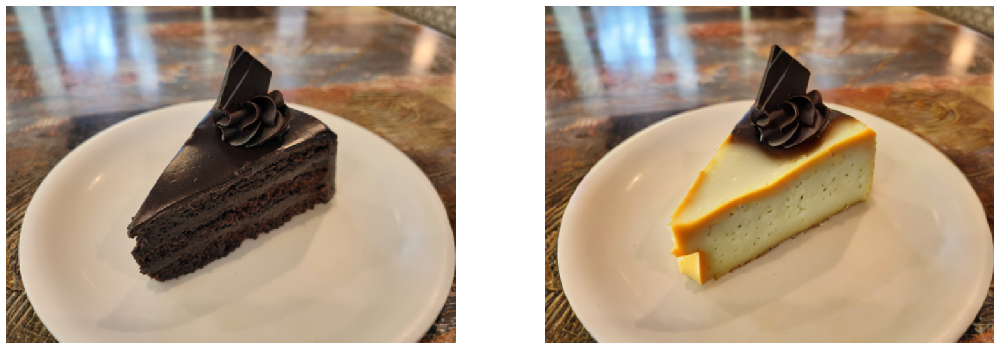

In [115]:
img_path = "images/photos/20221221_112930.jpg"
prompt = "replace the cake with a similar shaped cheese"

generate_image(img_path, prompt, 50, 7, 1.5)

100%|██████████| 50/50 [00:06<00:00,  7.98it/s]


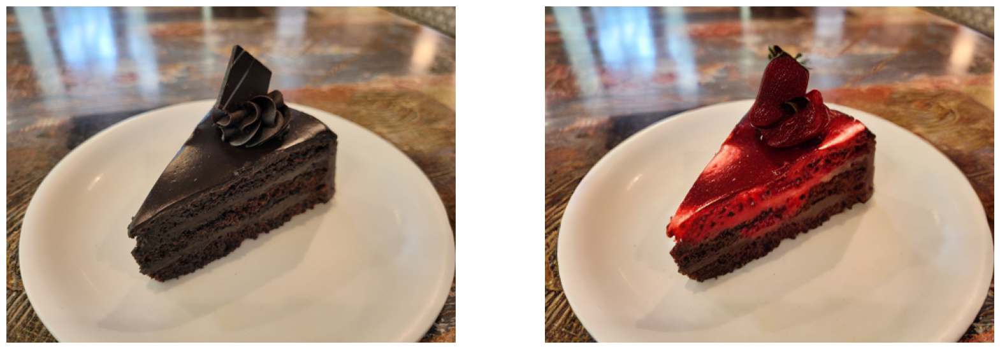

In [121]:
img_path = "images/photos/20221221_112930.jpg"
prompt = "add a strawberry on top of the cake"

generate_image(img_path, prompt, 50, 5, 1.5)

100%|██████████| 50/50 [00:06<00:00,  7.88it/s]


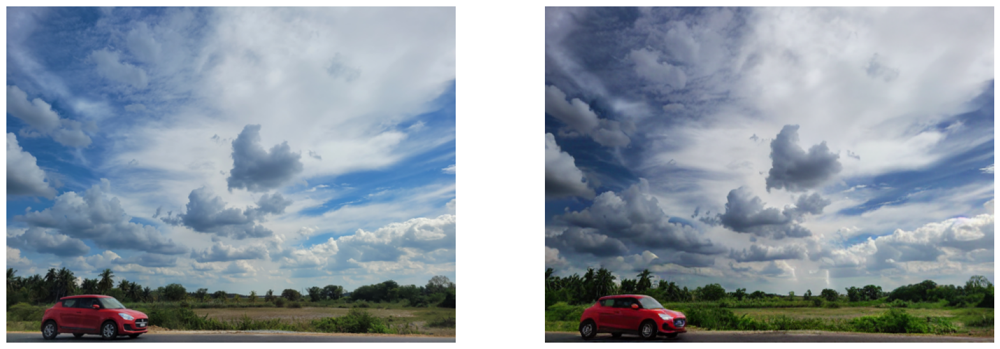

In [133]:
img_path = "images/photos/20221008_150110.jpg"
prompt = "change the weather to a thunderstorm with heavy rainfall"

generate_image(img_path, prompt, 50, 10, 1.5)

100%|██████████| 50/50 [00:06<00:00,  7.95it/s]


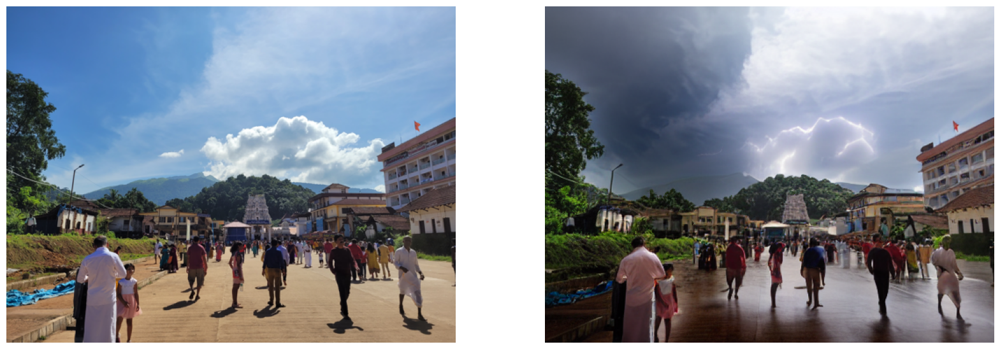

In [135]:
img_path = "images/photos/20221008_095009.jpg"
prompt = "change the weather to a thunderstorm with heavy rainfall"

generate_image(img_path, prompt, 50, 10, 1.5)

100%|██████████| 50/50 [00:06<00:00,  7.90it/s]


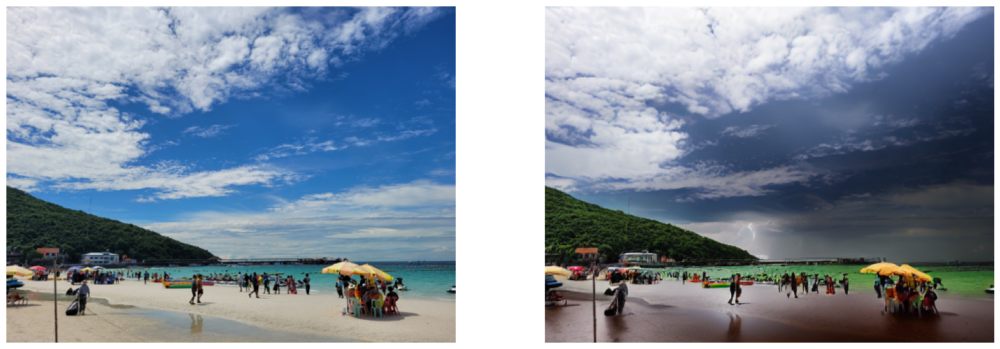

In [134]:
img_path = "images/photos/20221010_133840.jpg"
prompt = "change the weather to a thunderstorm with heavy rainfall"

generate_image(img_path, prompt, 50, 10, 1.5)

100%|██████████| 50/50 [00:06<00:00,  8.01it/s]


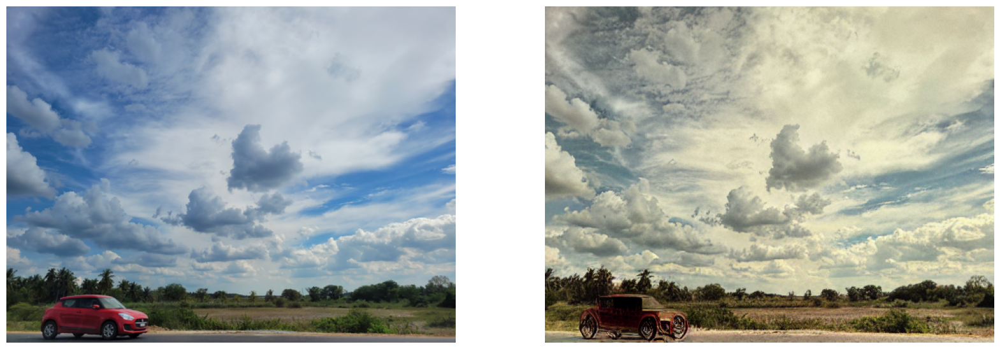

In [139]:
img_path = "images/photos/20221008_150110.jpg"
prompt = "turn the time back to 1900"

generate_image(img_path, prompt, 50, 7.5, 1.5)

100%|██████████| 50/50 [00:06<00:00,  8.06it/s]


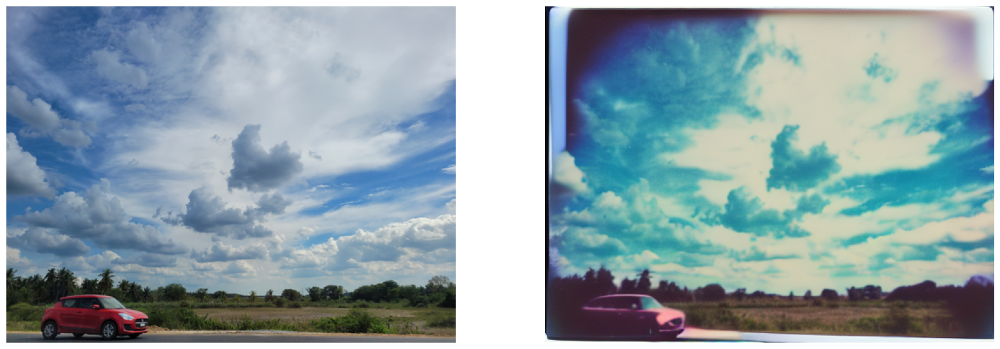

In [144]:
img_path = "images/photos/20221008_150110.jpg"
prompt = "turn it into a polaroid photo"

generate_image(img_path, prompt, 50, 7.5, 1.5)

100%|██████████| 50/50 [00:06<00:00,  8.02it/s]


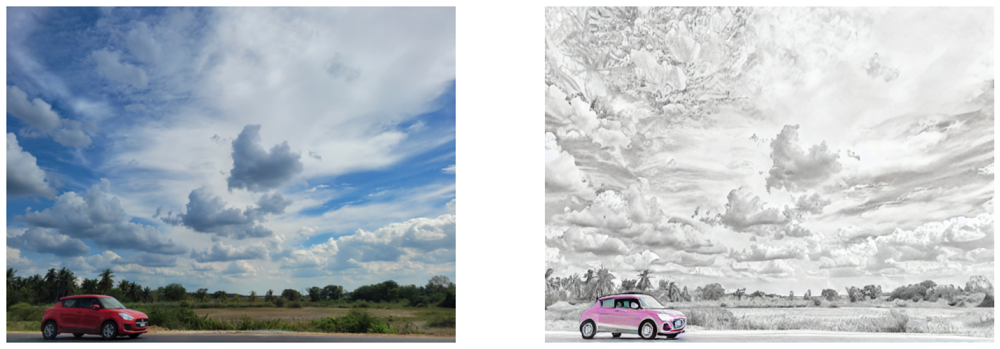

In [147]:
img_path = "images/photos/20221008_150110.jpg"
prompt = "turn into a coloring book style, with same colors as originally"

generate_image(img_path, prompt, 50, 7.5, 1.5)

100%|██████████| 50/50 [00:06<00:00,  8.12it/s]


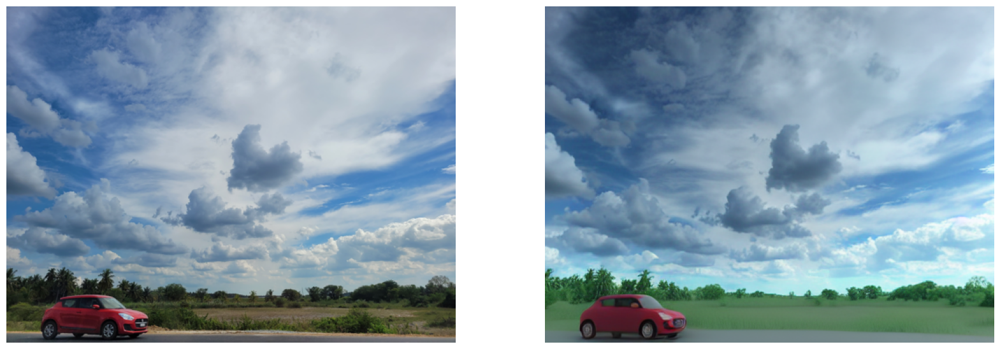

In [148]:
img_path = "images/photos/20221008_150110.jpg"
prompt = "turn into a 3D Illustration"

generate_image(img_path, prompt, 50, 7.5, 1.5)

100%|██████████| 50/50 [00:06<00:00,  8.07it/s]


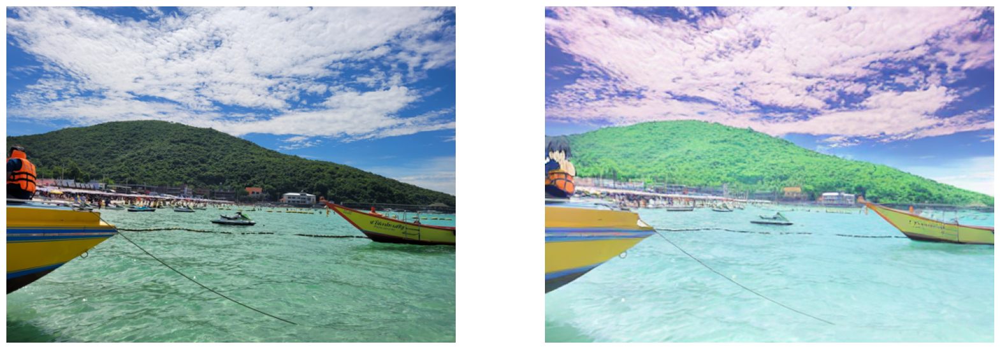

In [149]:
img_path = "images/photos/20221010_134630.jpg"
prompt = "turn into Anime Art"

generate_image(img_path, prompt, 50, 7.5, 1.5)

100%|██████████| 50/50 [00:04<00:00, 10.09it/s]


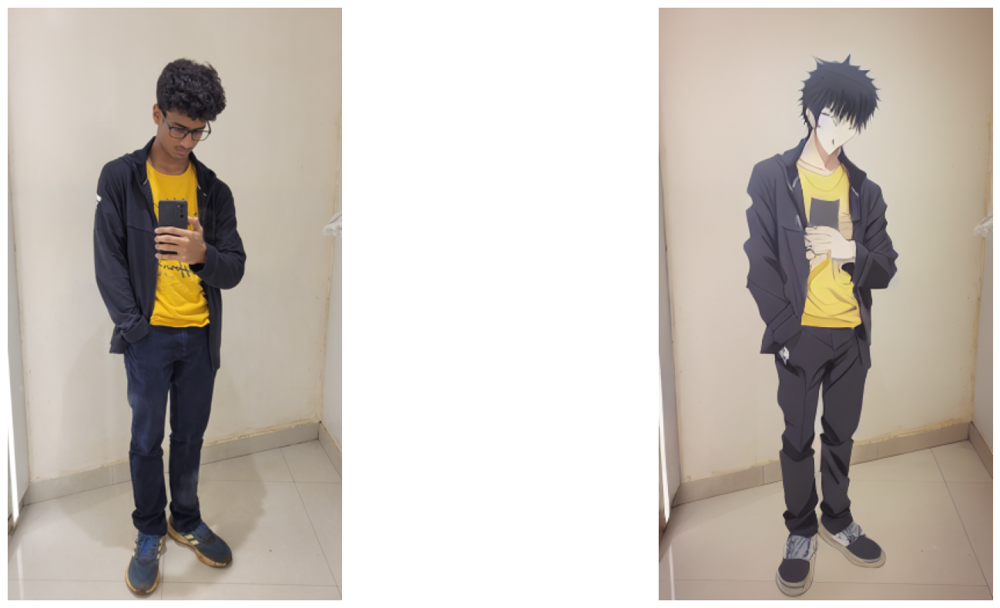

In [152]:
img_path = "images/photos/20230701_184801.jpg"
prompt = "turn into anime art"

generate_image(img_path, prompt, 50, 6, 1.5)

100%|██████████| 50/50 [00:04<00:00, 10.24it/s]


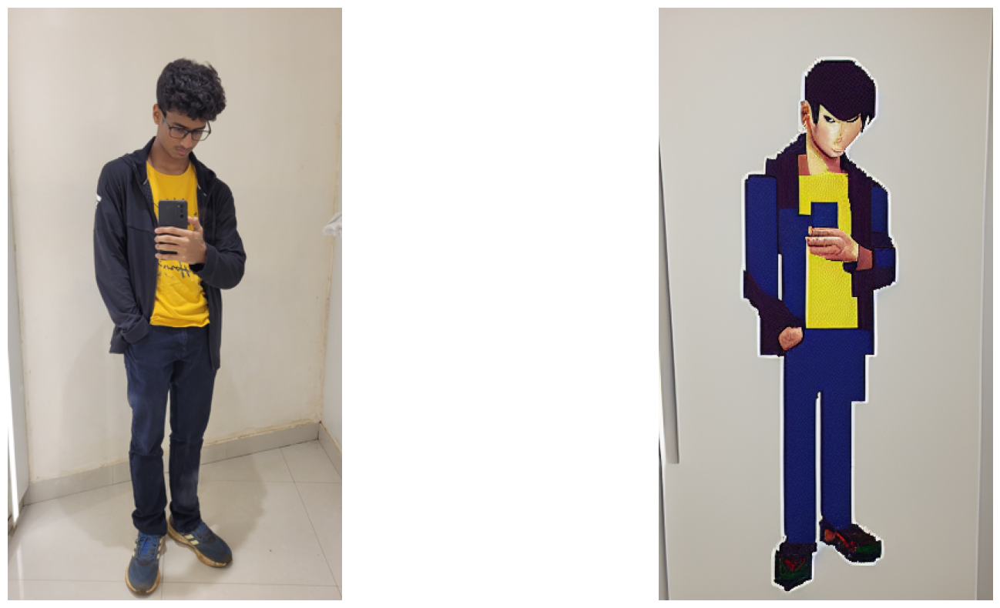

In [153]:
img_path = "images/photos/20230701_184801.jpg"
prompt = "turn into pixel art"

generate_image(img_path, prompt, 50, 6, 1.5)